In [2]:
import pandas as pd
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt
import plotly.express as px
import cufflinks as cf
from sklearn.linear_model import LinearRegression
from collections import Counter
import joblib

In [3]:
#Importing Train and Test data
df = pd.read_csv(r"D:\MSBA Study Materials\Projects\Data and Programming\train.csv")

df_test = pd.read_csv(r"D:\MSBA Study Materials\Projects\Data and Programming\test.csv")

In [4]:
def check(df):
    list_check=[]
    columns=df.columns
    
    for col in columns:
        dtypes=df[col].dtypes
        nunique=df[col].nunique()
        sum_null=df[col].isnull().sum()
        list_check.append([col,dtypes,nunique,sum_null])
    df_check=pd.DataFrame(list_check, columns=['column','dtypes','nunique','sum_null'])
        
    return df_check

check(df)

,column,dtypes,nunique,sum_null
0,Unnamed: 0,int64,103904,0
1,id,int64,103904,0
2,Gender,object,2,0
3,Customer Type,object,2,0
4,Age,int64,75,0
5,Type of Travel,object,2,0
6,Class,object,3,0
7,Flight Distance,int64,3802,0
8,Inflight wifi service,int64,6,0
9,Departure/Arrival time convenient,int64,6,0


In [5]:
null_data=(df.isnull().mean().sort_values(ascending=False)*100).reset_index()
null_data.rename(columns={0:"Average"},inplace=True)
null_data
# fig=px.histogram(null_data,x="Average",y="index",title="Percentage of Missing values",color="index",labels={"Average":"Percentage of missing values","index":"Column Names"})

# fig.show()

,index,Average
0,Arrival Delay in Minutes,0.298352
1,Unnamed: 0,0.000000
2,Online boarding,0.000000
3,Departure Delay in Minutes,0.000000
4,Cleanliness,0.000000
5,Inflight service,0.000000
6,Checkin service,0.000000
7,Baggage handling,0.000000
8,Leg room service,0.000000
9,On-board service,0.000000


In [6]:
diff = dict(df.groupby("satisfaction")["Arrival Delay in Minutes"].mean())
df["Arrival Delay in Minutes"] = df["Arrival Delay in Minutes"].fillna(df.satisfaction.map(diff))
df.isnull().sum()
df.drop("Unnamed: 0", axis = 1, inplace = True)
df.isnull().sum()

df.head()

,id,Gender,Customer Type,Age,Type of Travel,Class,Flight Distance,Inflight wifi service,Departure/Arrival time convenient,Ease of Online booking,...,Inflight entertainment,On-board service,Leg room service,Baggage handling,Checkin service,Inflight service,Cleanliness,Departure Delay in Minutes,Arrival Delay in Minutes,satisfaction
0,70172,Male,Loyal Customer,13,Personal Travel,Eco Plus,460,3,4,3,...,5,4,3,4,4,5,5,25,18.0,neutral or dissatisfied
1,5047,Male,disloyal Customer,25,Business travel,Business,235,3,2,3,...,1,1,5,3,1,4,1,1,6.0,neutral or dissatisfied
2,110028,Female,Loyal Customer,26,Business travel,Business,1142,2,2,2,...,5,4,3,4,4,4,5,0,0.0,satisfied
3,24026,Female,Loyal Customer,25,Business travel,Business,562,2,5,5,...,2,2,5,3,1,4,2,11,9.0,neutral or dissatisfied
4,119299,Male,Loyal Customer,61,Business travel,Business,214,3,3,3,...,3,3,4,4,3,3,3,0,0.0,satisfied


In [6]:
df.columns

Index(['id', 'Gender', 'Customer Type', 'Age', 'Type of Travel', 'Class',
       'Flight Distance', 'Inflight wifi service',
       'Departure/Arrival time convenient', 'Ease of Online booking',
       'Gate location', 'Food and drink', 'Online boarding', 'Seat comfort',
       'Inflight entertainment', 'On-board service', 'Leg room service',
       'Baggage handling', 'Checkin service', 'Inflight service',
       'Cleanliness', 'Departure Delay in Minutes', 'Arrival Delay in Minutes',
       'satisfaction'],
      dtype='object')

In [8]:
px.
temp = df.groupby('Class')[['Flight Distance','Age']].mean().reset_index()
px.histogram(temp, x = 'Class' , y='Flight Distance', color = 'Age' ,barmode ='group' )

In [8]:
Eco_class = df[df['Class'] == 'Eco']
Eco_class = Eco_class.mean().reset_index()
Eco_class.columns = ['index', 'Mean']
Eco_class

C:\Users\rahul\AppData\Local\Temp\ipykernel_4844\624026767.py:2: FutureWarning:

Dropping of nuisance columns in DataFrame reductions (with 'numeric_only=None') is deprecated; in a future version this will raise TypeError.  Select only valid columns before calling the reduction.



,index,Mean
0,id,61606.757364
1,Age,37.164253
2,Flight Distance,743.439748
3,Inflight wifi service,2.675067
4,Departure/Arrival time convenient,3.199123
5,Ease of Online booking,2.605241
6,Gate location,2.971954
7,Food and drink,3.086277
8,Online boarding,2.812985
9,Seat comfort,3.138838


In [9]:
Eco_class.drop(index =[0,2], inplace=True)
px.histogram(Eco_class, x='index', y='Mean', color = 'index')

In [10]:
Business_class = df[df['Class'] == 'Business']
Business_class  = (Business_class.mean()).reset_index()
Business_class.columns = ['index', 'Mean']


C:\Users\rahul\AppData\Local\Temp\ipykernel_4844\1205014299.py:2: FutureWarning:

Dropping of nuisance columns in DataFrame reductions (with 'numeric_only=None') is deprecated; in a future version this will raise TypeError.  Select only valid columns before calling the reduction.



In [11]:
Business_class.drop(index = [0,2], inplace = True)
px.histogram(Business_class, x = 'index', y = 'Mean', color='index')

In [12]:
diff = dict(df_test.groupby("satisfaction")["Arrival Delay in Minutes"].mean())
df_test["Arrival Delay in Minutes"] = df_test["Arrival Delay in Minutes"].fillna(df_test.satisfaction.map(diff))
df_test.isnull().sum()
df_test.drop("Unnamed: 0", axis = 1, inplace = True)
df_test.isnull().sum()


id                                   0
Gender                               0
Customer Type                        0
Age                                  0
Type of Travel                       0
Class                                0
Flight Distance                      0
Inflight wifi service                0
Departure/Arrival time convenient    0
Ease of Online booking               0
Gate location                        0
Food and drink                       0
Online boarding                      0
Seat comfort                         0
Inflight entertainment               0
On-board service                     0
Leg room service                     0
Baggage handling                     0
Checkin service                      0
Inflight service                     0
Cleanliness                          0
Departure Delay in Minutes           0
Arrival Delay in Minutes             0
satisfaction                         0
dtype: int64

In [13]:
fig = px.histogram(df, x="satisfaction")
fig.show()

In [14]:
categorical_columns = df.select_dtypes(include = ['object'])
numerical_columns = df.select_dtypes(exclude =['object']) 

df_num_cat = pd.DataFrame()
df_num_cat['Number of Numerical Columns'] = [numerical_columns.shape[1]]
df_num_cat['Number of Categorical Columns'] = [categorical_columns.shape[1]]
df_num_cat_transpose = df_num_cat.T.reset_index()
df_num_cat_transpose.rename(columns={0:"Count"},inplace=True)

fig=px.bar(df_num_cat_transpose,x="index",y= "Count",title="Count of Categorical and Numerical Columns",color="index",labels={"index":"Categorical or Numerical Columns",0:"Count"})
fig.show()

In [15]:
categorical_columns.describe().T

,count,unique,top,freq
Gender,103904,2,Female,52727
Customer Type,103904,2,Loyal Customer,84923
Type of Travel,103904,2,Business travel,71655
Class,103904,3,Business,49665
satisfaction,103904,2,neutral or dissatisfied,58879


In [16]:
numerical_columns.describe().T

,count,mean,std,min,25%,50%,75%,max
id,103904.0,64924.210502,37463.812252,1.0,32533.75,64856.5,97368.25,129880.0
Age,103904.0,39.379706,15.114964,7.0,27.00,40.0,51.00,85.0
Flight Distance,103904.0,1189.448375,997.147281,31.0,414.00,843.0,1743.00,4983.0
Inflight wifi service,103904.0,2.729683,1.327829,0.0,2.00,3.0,4.00,5.0
Departure/Arrival time convenient,103904.0,3.060296,1.525075,0.0,2.00,3.0,4.00,5.0
Ease of Online booking,103904.0,2.756901,1.398929,0.0,2.00,3.0,4.00,5.0
Gate location,103904.0,2.976883,1.277621,0.0,2.00,3.0,4.00,5.0
Food and drink,103904.0,3.202129,1.329533,0.0,2.00,3.0,4.00,5.0
Online boarding,103904.0,3.250375,1.349509,0.0,2.00,3.0,4.00,5.0
Seat comfort,103904.0,3.439396,1.319088,0.0,2.00,4.0,5.00,5.0


In [17]:
def detect_outliers(df,features):
    outlier_indices=[]
    
    for c in features:
        Q1=np.percentile(df[c],25)
        
        Q3=np.percentile(df[c],75)
        
        IQR= Q3-Q1
        
        outlier_step= IQR * 1.5
        
        outlier_list_col = df[(df[c]< Q1 - outlier_step)|( df[c] > Q3 + outlier_step)].index
        
        outlier_indices.extend(outlier_list_col)
        
                
    outliers_indices = Counter(outlier_indices)
    multiple_outliers = list(i for i, v in outliers_indices.items() if v>2)
    return multiple_outliers

df.loc[detect_outliers(df, ['Age', 'Flight Distance', 'Departure Delay in Minutes', 'Arrival Delay in Minutes'])]

,id,Gender,Customer Type,Age,Type of Travel,Class,Flight Distance,Inflight wifi service,Departure/Arrival time convenient,Ease of Online booking,...,Inflight entertainment,On-board service,Leg room service,Baggage handling,Checkin service,Inflight service,Cleanliness,Departure Delay in Minutes,Arrival Delay in Minutes,satisfaction
80,73302,Male,Loyal Customer,26,Business travel,Business,3960,1,1,1,...,4,4,2,5,4,4,4,45,48.0,satisfied
446,3875,Female,Loyal Customer,44,Business travel,Business,3767,1,1,1,...,2,2,2,1,4,2,2,44,92.0,neutral or dissatisfied
458,96830,Male,Loyal Customer,37,Business travel,Business,3744,5,5,5,...,5,4,4,4,5,4,5,172,163.0,satisfied
717,129624,Male,Loyal Customer,32,Business travel,Business,3802,0,0,0,...,5,3,2,5,4,5,5,90,86.0,satisfied
1061,115386,Male,Loyal Customer,57,Business travel,Business,3902,1,1,1,...,5,5,5,5,4,5,3,55,53.0,satisfied
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
102044,22579,Female,Loyal Customer,41,Business travel,Business,3799,5,5,5,...,4,4,4,4,3,4,1,95,89.0,satisfied
102571,6783,Female,Loyal Customer,45,Business travel,Business,3810,1,1,1,...,4,4,4,4,3,4,3,70,111.0,satisfied
103101,99964,Female,Loyal Customer,48,Business travel,Business,3874,2,2,2,...,2,2,2,2,5,2,5,123,96.0,satisfied
103357,110139,Female,Loyal Customer,44,Business travel,Business,3891,5,5,5,...,3,3,3,3,3,3,3,54,38.0,satisfied


In [18]:
df = df.drop(detect_outliers(df,['Age', 'Flight Distance', 'Departure Delay in Minutes', 'Arrival Delay in Minutes']),axis = 0).reset_index(drop = True)

In [12]:
fig=px.pie(df,values=df["satisfaction"].value_counts(),
           names=["Satisfied","Dissatisfied"],title="<b>Satisfied And Dissatisfied", hole = 0.5)
fig.show()

In [20]:
fig=px.violin(df,y="Age",x="Gender",color="satisfaction",title="<b>Age vs Gender vs satisfaction")
fig.update_layout(template="plotly")
fig.show()

<AxesSubplot:>

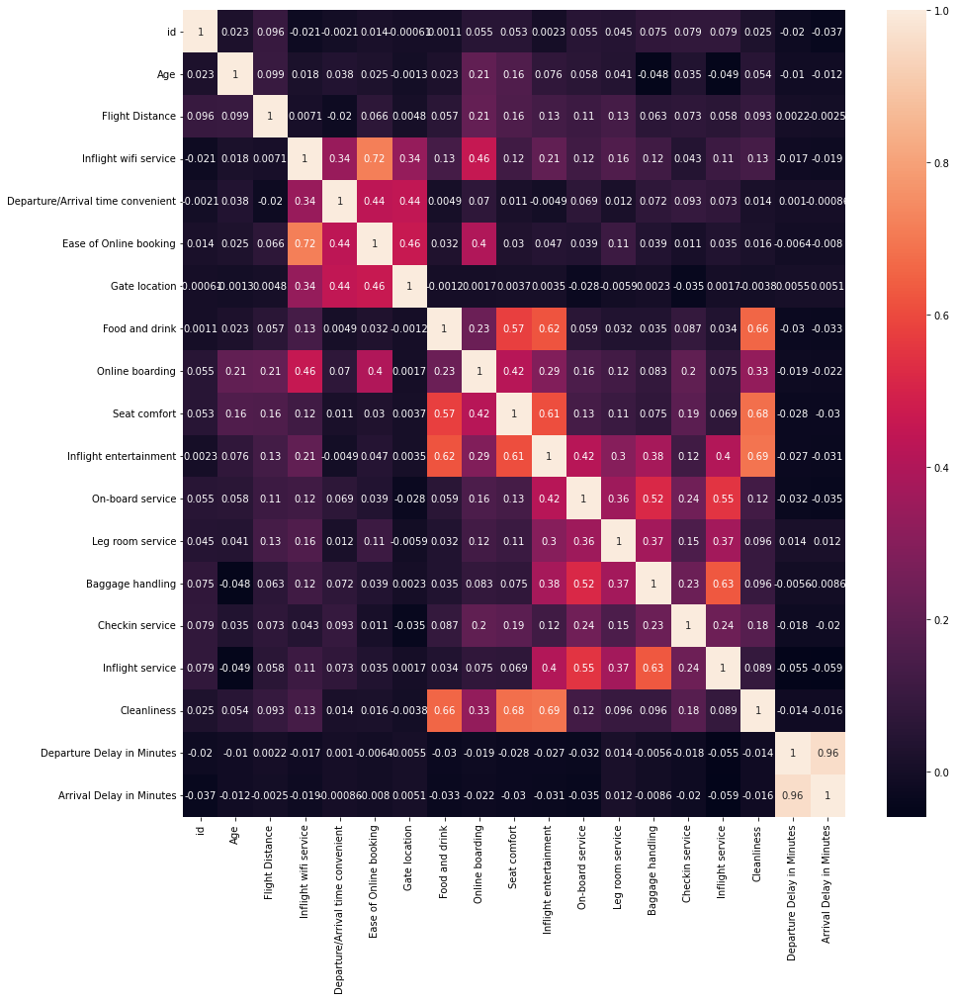

In [10]:
plt.figure(figsize=(15,15))
corr = df.corr()
sns.heatmap(corr, annot=True)

In [22]:
cols  = ['satisfaction']
dummies = pd.get_dummies(df[cols])
df = pd.concat([df,dummies],axis = 1)
df.head()

,id,Gender,Customer Type,Age,Type of Travel,Class,Flight Distance,Inflight wifi service,Departure/Arrival time convenient,Ease of Online booking,...,Leg room service,Baggage handling,Checkin service,Inflight service,Cleanliness,Departure Delay in Minutes,Arrival Delay in Minutes,satisfaction,satisfaction_neutral or dissatisfied,satisfaction_satisfied
0,70172,Male,Loyal Customer,13,Personal Travel,Eco Plus,460,3,4,3,...,3,4,4,5,5,25,18.0,neutral or dissatisfied,1,0
1,5047,Male,disloyal Customer,25,Business travel,Business,235,3,2,3,...,5,3,1,4,1,1,6.0,neutral or dissatisfied,1,0
2,110028,Female,Loyal Customer,26,Business travel,Business,1142,2,2,2,...,3,4,4,4,5,0,0.0,satisfied,0,1
3,24026,Female,Loyal Customer,25,Business travel,Business,562,2,5,5,...,5,3,1,4,2,11,9.0,neutral or dissatisfied,1,0
4,119299,Male,Loyal Customer,61,Business travel,Business,214,3,3,3,...,4,4,3,3,3,0,0.0,satisfied,0,1


In [23]:
cols  = ['satisfaction']
dummies = pd.get_dummies(df_test[cols])
df_test = pd.concat([df_test,dummies],axis = 1)
df_test.head()

,id,Gender,Customer Type,Age,Type of Travel,Class,Flight Distance,Inflight wifi service,Departure/Arrival time convenient,Ease of Online booking,...,Leg room service,Baggage handling,Checkin service,Inflight service,Cleanliness,Departure Delay in Minutes,Arrival Delay in Minutes,satisfaction,satisfaction_neutral or dissatisfied,satisfaction_satisfied
0,19556,Female,Loyal Customer,52,Business travel,Eco,160,5,4,3,...,5,5,2,5,5,50,44.0,satisfied,0,1
1,90035,Female,Loyal Customer,36,Business travel,Business,2863,1,1,3,...,4,4,3,4,5,0,0.0,satisfied,0,1
2,12360,Male,disloyal Customer,20,Business travel,Eco,192,2,0,2,...,1,3,2,2,2,0,0.0,neutral or dissatisfied,1,0
3,77959,Male,Loyal Customer,44,Business travel,Business,3377,0,0,0,...,1,1,3,1,4,0,6.0,satisfied,0,1
4,36875,Female,Loyal Customer,49,Business travel,Eco,1182,2,3,4,...,2,2,4,2,4,0,20.0,satisfied,0,1


<AxesSubplot:xlabel='Class', ylabel='count'>

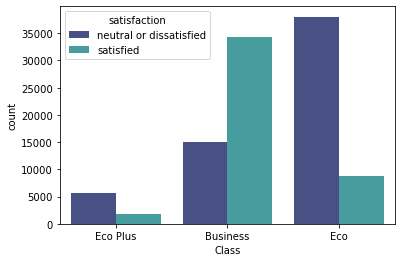

In [24]:
sns.countplot(data = df ,x = df["Class"], hue = "satisfaction", palette = "mako")

<AxesSubplot:xlabel='Type of Travel', ylabel='count'>

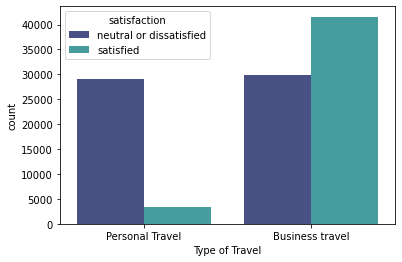

In [25]:
sns.countplot(data = df ,x = df["Type of Travel"], hue = "satisfaction", palette = "mako")

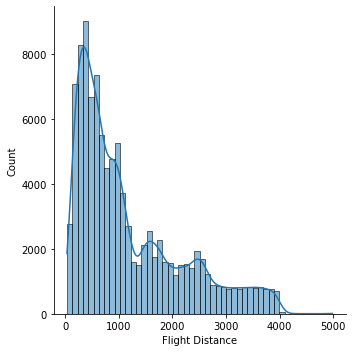

In [26]:
sns.displot(df["Flight Distance"], kde= True, bins= 50)

In [27]:
df.columns

Index(['id', 'Gender', 'Customer Type', 'Age', 'Type of Travel', 'Class',
       'Flight Distance', 'Inflight wifi service',
       'Departure/Arrival time convenient', 'Ease of Online booking',
       'Gate location', 'Food and drink', 'Online boarding', 'Seat comfort',
       'Inflight entertainment', 'On-board service', 'Leg room service',
       'Baggage handling', 'Checkin service', 'Inflight service',
       'Cleanliness', 'Departure Delay in Minutes', 'Arrival Delay in Minutes',
       'satisfaction', 'satisfaction_neutral or dissatisfied',
       'satisfaction_satisfied'],
      dtype='object')

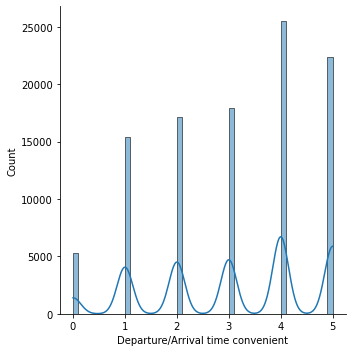

In [28]:
sns.displot(df['Departure/Arrival time convenient'], kde= True, bins= 50)

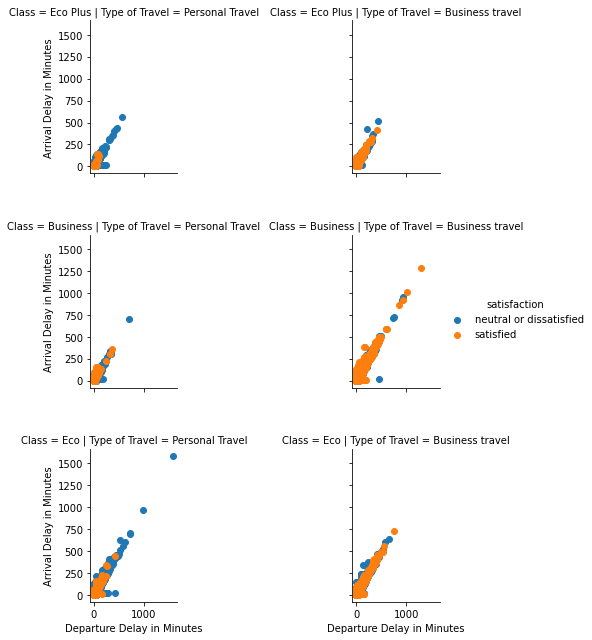

In [29]:
g = sns.FacetGrid(df, row="Class", col="Type of Travel", hue = 'satisfaction')
g.map(plt.scatter, "Departure Delay in Minutes", "Arrival Delay in Minutes")
plt.subplots_adjust(hspace=0.4, wspace=2)
g.add_legend()

In [30]:
fig = px.histogram(df, x="Customer Type", color="satisfaction")
fig.show()

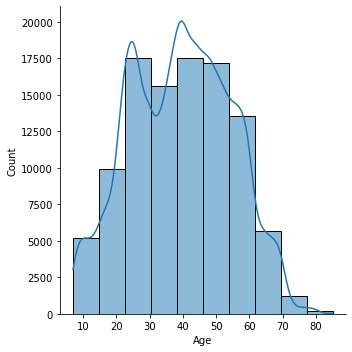

In [34]:
sns.displot(df["Age"], kde= True, bins= 10)

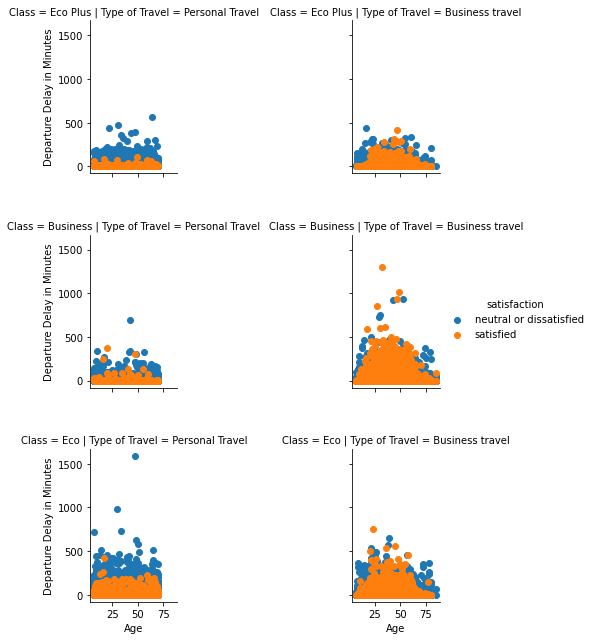

In [35]:
g = sns.FacetGrid(df, row="Class", col="Type of Travel", hue = 'satisfaction')
g.map(plt.scatter, "Age", "Departure Delay in Minutes")
plt.subplots_adjust(hspace=0.4, wspace=2)
g.add_legend()

In [36]:
#Filtering the Dataset with only Loyal Customers as the Customer Type
dissatisfied_customers_df = df[df["satisfaction"] == "neutral or dissatisfied"]

#Visualising Class wise Satisfaction Rating for Loyal Customers
fig1 = px.sunburst(dissatisfied_customers_df,path=["Class", "Customer Type"],template="plotly", title = "<b>Class wise Customer Type for Dissatisfied Customers")
fig1.show()

C:\ProgramData\Anaconda3\lib\site-packages\plotly\express\_core.py:1637: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

C:\ProgramData\Anaconda3\lib\site-packages\plotly\express\_core.py:1637: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.



In [51]:
l1 = []
for x in round(df.iloc[:, 7:21].mean(), 2):
    l1.append(x)
l1

[2.73,
 3.06,
 2.76,
 2.98,
 3.2,
 3.25,
 3.44,
 3.36,
 3.38,
 3.35,
 3.63,
 3.3,
 3.64,
 3.29]

In [52]:
short_medium_flight = df[df['Flight Distance'] < 3000]
l1 = []
for x in round(short_medium_flight.iloc[:, 7:21].mean(), 2):
    l1.append(x)
print(l1)

[2.73, 3.07, 2.74, 2.97, 3.19, 3.19, 3.4, 3.32, 3.35, 3.32, 3.62, 3.29, 3.63, 3.26]


In [53]:
long_flight = df[df['Flight Distance'] > 3000]
l1 = []
for x in round(long_flight.iloc[:, 7:21].mean(), 2):
    l1.append(x)
print(l1)

[2.74, 2.94, 2.92, 3.0, 3.39, 3.92, 3.91, 3.79, 3.7, 3.73, 3.79, 3.48, 3.79, 3.56]


In [37]:
px.histogram(df, x="Age", nbins = 10, color="satisfaction", color_discrete_sequence=[
                 "orange", "purple"])


In [54]:
import plotly.graph_objects as go

categories = []
for x in df.iloc[:, 7:21]:
    categories.append(x)

fig = go.Figure()


fig.add_trace(go.Scatterpolar(
      r = [2.74, 2.94, 2.92, 3.0, 3.39, 3.92, 3.91, 3.79, 3.7, 3.73, 3.79, 3.48, 3.79, 3.56],
      theta=categories,
      fill='toself',
      name='Long Distance'

))
fig.add_trace(go.Scatterpolar(
      r = [2.73, 3.07, 2.74, 2.97, 3.19, 3.19, 3.4, 3.32, 3.35, 3.32, 3.62, 3.29, 3.63, 3.26],
      theta=categories,
      fill='toself',
      name='Short or Medium Distance'

))

fig.update_layout(
  polar=dict(
    radialaxis=dict(
      visible=True,
      range=[0, 5]
    )),title = "<b>Radar Chart of Average ratings of Services based on Flight Distance",
  showlegend=True
)

fig.show()

In [38]:
fig = px.scatter(df, x="Departure Delay in Minutes", y="Arrival Delay in Minutes",
	         size="Flight Distance", color="satisfaction")
fig.show()

<AxesSubplot:>

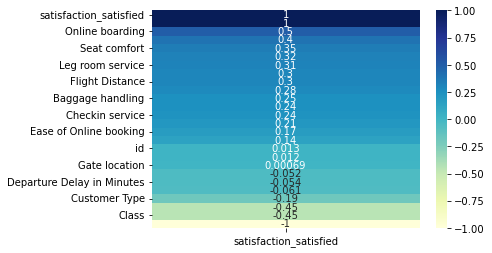

In [58]:
sat_corr = df.corr()[["satisfaction_satisfied"]].sort_values(by='satisfaction_satisfied', ascending=False)
sns.heatmap(sat_corr, annot=True, cmap="YlGnBu")

<AxesSubplot:>

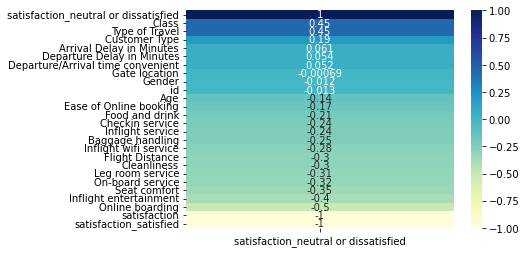

In [59]:
sat_corr = df.corr()[["satisfaction_neutral or dissatisfied"]].sort_values(by='satisfaction_neutral or dissatisfied', ascending=False)
sns.heatmap(sat_corr, annot=True, cmap="YlGnBu", xticklabels=True, yticklabels=True)

In [39]:
from sklearn.preprocessing import LabelEncoder
df['Gender'] = df['Gender'].astype('str')
df['Class'] = df['Class'].astype('str')
df['Customer Type'] = df['Customer Type'].astype('str')
df['Type of Travel'] = df['Type of Travel'].astype('str')

df['satisfaction'] = df['satisfaction'].astype('str')
        
df[['Gender', 'Customer Type','Type of Travel','Class','satisfaction']] =  df[['Gender', 'Customer Type', 'Type of Travel', 'Class','satisfaction']].apply(LabelEncoder().fit_transform)

In [40]:
from sklearn.preprocessing import LabelEncoder
df_test['Gender'] = df_test['Gender'].astype('str')
df_test['Class'] = df['Class'].astype('str')
df_test['Customer Type'] = df_test['Customer Type'].astype('str')
df_test['Type of Travel'] = df_test['Type of Travel'].astype('str')

df_test['satisfaction'] = df_test['satisfaction'].astype('str')
        
df_test[['Gender', 'Customer Type','Type of Travel','Class','satisfaction']] =  df_test[['Gender', 'Customer Type', 'Type of Travel', 'Class','satisfaction']].apply(LabelEncoder().fit_transform)

In [41]:
from sklearn.tree import DecisionTreeClassifier
from sklearn import metrics

X = df.drop('satisfaction', axis = 1)
y = df.satisfaction
X_test = df_test.drop('satisfaction', axis = 1)
y_test = df_test.satisfaction

In [42]:
clf = DecisionTreeClassifier()
clf = clf.fit(X,y)
y_pred = clf.predict(X_test)

In [43]:
print("Accuracy:",metrics.accuracy_score(y_test, y_pred))

Accuracy: 1.0


In [44]:
from sklearn.ensemble import RandomForestClassifier

rfc = RandomForestClassifier(n_estimators = 100) 
 
# Training the model on the training dataset
# fit function is used to train the model using the training sets as parameters
rfc.fit(X, y)
 
# performing predictions on the test dataset
y_pred_rfc = rfc.predict(X_test)
print("Accuracy:",metrics.accuracy_score(y_test, y_pred_rfc))

Accuracy: 1.0


C:\Users\rahul\AppData\Roaming\Python\Python39\site-packages\sklearn\utils\deprecation.py:87: FutureWarning:

Function plot_confusion_matrix is deprecated; Function `plot_confusion_matrix` is deprecated in 1.0 and will be removed in 1.2. Use one of the class methods: ConfusionMatrixDisplay.from_predictions or ConfusionMatrixDisplay.from_estimator.



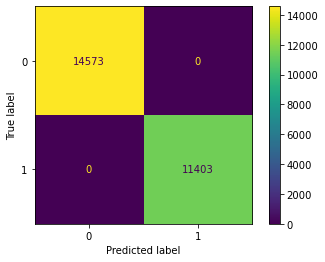

In [45]:
from sklearn.metrics import plot_confusion_matrix
plot_confusion_matrix(clf, X_test, y_test)
plt.show()

In [60]:
from sklearn.linear_model import LinearRegression
X = df.drop('satisfaction' , axis=1)
y = df.satisfaction 
reg = LinearRegression()
reg.fit(X, y)

y_pred_lr = reg.predict(X_test)

In [61]:
X = df.drop('satisfaction' , axis=1)
y = df.satisfaction

X_test = df_test.drop('satisfaction' , axis=1)
y = df_test.satisfaction

In [62]:
from sklearn.neighbors import KNeighborsClassifier
knn = KNeighborsClassifier(n_neighbors=4)

from mlxtend.feature_selection import SequentialFeatureSelector as sfs

X = df.drop('satisfaction' , axis=1)
y = df.satisfaction 

In [63]:
sfs1 = sfs(knn, 
           k_features=(1,13), 
           forward=True, 
           floating=False, 
           verbose=2,
           scoring='accuracy',
           cv=5)


In [64]:
sfs1 = sfs1.fit(X,y)
sfs1

[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    1.4s remaining:    0.0s
[Parallel(n_jobs=1)]: Done  25 out of  25 | elapsed:  6.6min finished

[2023-01-31 19:38:01] Features: 1/13 -- score: 1.0[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    1.4s remaining:    0.0s
[Parallel(n_jobs=1)]: Done  24 out of  24 | elapsed:  4.5min finished

[2023-01-31 19:42:30] Features: 2/13 -- score: 1.0[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    1.6s remaining:    0.0s
[Parallel(n_jobs=1)]: Done  23 out of  23 | elapsed:  3.4min finished

[2023-01-31 19:45:52] Features: 3/13 -- score: 1.0[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    2.3s remaining:  

SequentialFeatureSelector(estimator=KNeighborsClassifier(n_neighbors=4),
                          k_features=(1, 13), scoring='accuracy', verbose=2)

In [73]:
#sfs2.subsets_

In [ ]:
from mlxtend.plotting import plot_sequential_feature_selection as plot_sfs
fig1 = plot_sfs(sfs2.get_metric_dict(),
                kind='std_dev',
                figsize=(6, 4))

In [66]:
from sklearn.tree import DecisionTreeClassifier
from sklearn import metrics
df = df.drop(['satisfaction_satisfied','satisfaction_neutral or dissatisfied'],axis = 1)
X = df.drop('satisfaction', axis = 1)
y = df.satisfaction
X_test = df_test.drop('satisfaction', axis = 1)
y_test = df_test.satisfaction

In [68]:
#clf = DecisionTreeClassifier()
#clf = clf.fit(X,y)
#y_pred = clf.predict(X_test)

In [ ]:
print("Accuracy:",metrics.accuracy_score(y_test, y_pred))

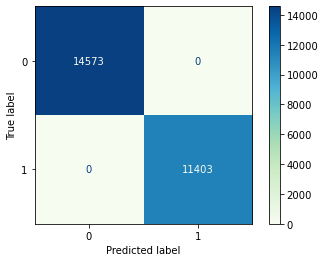

In [69]:
from sklearn.metrics import confusion_matrix, ConfusionMatrixDisplay
cm = confusion_matrix(y_test, y_pred)
disp = ConfusionMatrixDisplay(confusion_matrix=cm)
disp.plot(cmap = 'GnBu')
plt.show()

In [71]:
#from sklearn.ensemble import RandomForestClassifier

#rfc = RandomForestClassifier(n_estimators = 100) 
 
# Training the model on the training dataset
# fit function is used to train the model using the training sets as parameters
#rfc.fit(X, y)
 
# performing predictions on the test dataset
#y_pred_rfc = rfc.predict(X_test)
#print("Accuracy:",metrics.accuracy_score(y_test, y_pred_rfc))

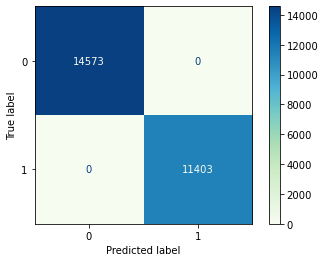

In [72]:
cm = confusion_matrix(y_test, y_pred_rfc)
disp = ConfusionMatrixDisplay(confusion_matrix=cm)
disp.plot(cmap = 'GnBu')
plt.show()